### Imports:

In [831]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from PIL import Image
import os
from tqdm import tqdm

import cv2
import skimage
from scipy.ndimage import binary_fill_holes
from skimage import img_as_ubyte
from skimage.color import rgb2gray, rgb2hsv
from skimage.exposure import equalize_hist, histogram
from skimage.feature import canny
from skimage.filters import threshold_otsu, unsharp_mask, gaussian
from skimage.measure import find_contours, approximate_polygon
from skimage.morphology import (dilation, erosion, binary_closing, binary_opening, remove_small_holes,
                                remove_small_objects, thin, convex_hull_image, square, disk, diamond)
from skimage.util import invert

### Basic functions

In [987]:
def to_1ch(img, mode='gray'):
#     img = np.copy(img)
    transf_1ch = (
        {'r': lambda img: img[:, :, 0],
         'g': lambda img: img[:, :, 1],
         'b': lambda img: img[:, :, 2],
         'h': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 0]),
         's': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 1]),
         'v': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 2]),
         'gray': lambda img: img_as_ubyte(rgb2gray(img))}
    )
    return transf_1ch[mode](img)

In [611]:
def to_bin(img, thr='otsu'):
    if thr == 'otsu':
        return img > threshold_otsu(img)
    else:
        if thr < 1:
            return img > 255 * thr
        else:
            return img > thr

In [4]:
def to_bin_uint8(img):
    return img.astype(np.uint8) * 255

In [5]:
def list_get(list_, ind_, default_):
  try:
    return list_[ind_]
  except IndexError:
    return default_

In [189]:
def set_padding(img, num, val=False):
    if num > 0:
        h, w = img.shape
        new_img = np.full((h + 2 * num, w + 2 * num), val)
        new_img[num:-num, num:-num] = img
        img = new_img.astype(img.dtype)
    elif num < 0:
        num = -num
        img = img[num:-num, num:-num]
    return img

In [7]:
def resize_prop(img, max_size):
    h, w = img.shape[:2]
    img_max_size = max(w, h)
    if max_size < img_max_size:
        ratio = img_max_size / max_size
        w, h = int(w / ratio), int(h / ratio)
        
        img = cv2.resize(img, (w, h),
                         interpolation=cv2.INTER_AREA)
    return img

In [1084]:
def show_images(img_arr, name_arr=[], n_in_row=3, factor_r=8, factor_c=8, figsize=None,
         title=None, cmap_='Greys', label_fontsize=12, tick_fontsize=11, save_path=None):
    if type(img_arr) is np.ndarray:
        quant = img_arr.shape[0]
    elif type(img_arr) is list:
        quant = len(img_arr)
    cols = min(quant, n_in_row)
    rows = quant // n_in_row + (1 if quant % n_in_row else 0)
    if figsize is None:
        figsize = (int(factor_c * cols), int(factor_r * rows))
    fig = plt.figure(figsize=figsize)
    if title is not None:
        fig.suptitle(title, fontsize=14, y = 0.88)
    for i, img in enumerate(img_arr):
        ax = fig.add_subplot(rows, cols, i + 1)
        if type(img) is tuple:
            x, y = img
            ax.plot(x, y)
            ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize)
        else:
            ax.imshow(img, cmap=cmap_)
#             print(name_arr[i], len(img_arr), len(name_arr))
            ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize)
            ax.xaxis.set_major_locator(MaxNLocator(integer=True))
            ax.yaxis.set_major_locator(MaxNLocator(integer=True))
            ax.xaxis.set_ticks_position('top')
            ax.tick_params(axis='both', labelsize=tick_fontsize)
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(f'{save_path}')
    plt.show()

In [9]:
def show_image_cv(img, name=''):
    if len(img.shape) == 3:
        img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    img = resize_prop(img, 700)
    cv2.imshow(name, img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

### Functions

In [1096]:
def show_images_cv(img_arr, name_arr=[]):
    for i, img in enumerate(img_arr):
        if len(img.shape) == 3:
            img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
        img = resize_prop(img, 700)
        cv2.imshow(list_get(name_arr, i, f'{i}'), img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

In [1097]:
show_images_cv([img, img])

### Input

In [10]:
src_images = []

input_folder = 'input'
src_names = os.listdir(input_folder)

In [11]:
for name in tqdm(src_names):
    img = cv2.imread(f'{input_folder}/{name}')
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    src_images.append(np.array(img))

100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 198.05it/s]


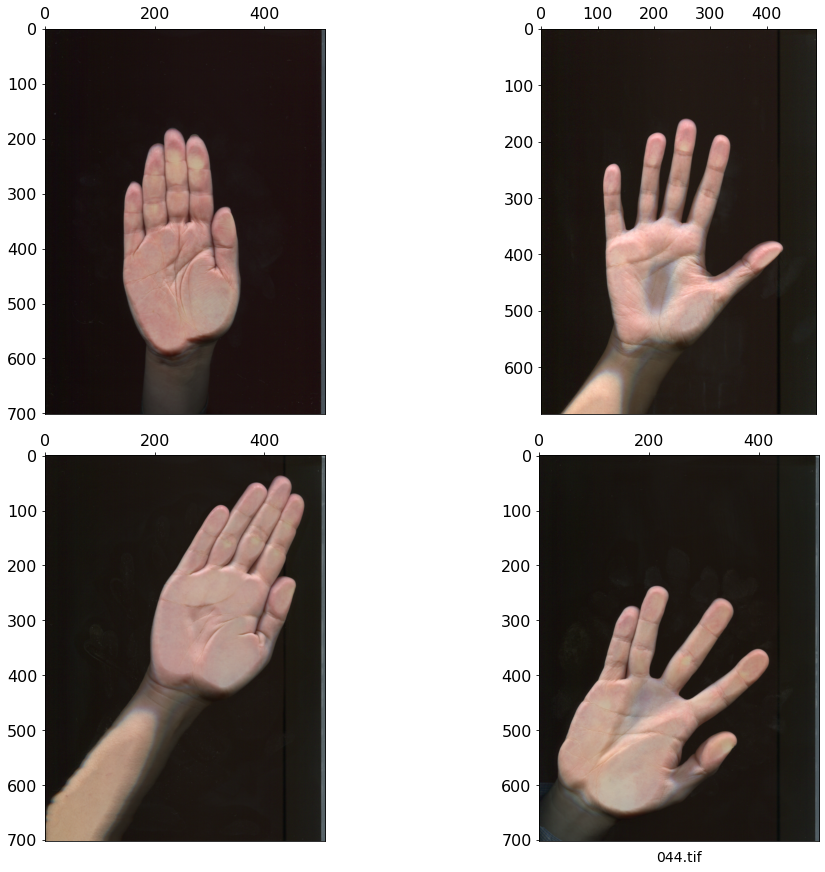

In [12]:
show_images(src_images, src_names)

In [13]:
src_images2 = []
for img in src_images:
    img = np.copy(img)
    src_images2.append(img[:, ::-1, :])

### Solution

In [14]:
def img_sub(img1, img2):
    src_dtype = img1.dtype
    img1, img2 = list(map(lambda x: x.astype(np.int32), [img1, img2]))

    img = img1 - img2
    img[img < 0] = 0

    img = img.astype(src_dtype)
    return img

def sharpen(img, size, count):
    img_blur = cv2.GaussianBlur(img, (size,size), 0)
    img = cv2.addWeighted(img, count + 1, img_blur, -count, 0)
    return img

def show_images_cv(img_arr, name_arr=[]):
    for i, img in enumerate(img_arr):
        if len(img.shape) == 3:
            img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
        img = resize_prop(img, 700)
        cv2.imshow(list_get(name_arr, i, ''), img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

def get_mask_2(img):
    img = to_1ch(img, 'r')
    img = sharpen(img, 3, 10)
    bin = cv2.threshold(img, 80, 255, cv2.THRESH_BINARY)[1] > 0
    bin = to_bin_uint8(erosion(bin, disk(2)))
    bin = to_bin_uint8(binary_closing(bin, disk(1)))
    bin = to_bin_uint8(binary_fill_holes(bin, disk(1)))
    return bin

def get_mask_1(img):
    img = to_1ch(img, 'r')

    blur = cv2.GaussianBlur(img, (3,3), 0)
    
    img_for_edge = img
    v, s, w = 2, 3, 1.2
    grad_x = cv2.Sobel(img_for_edge, cv2.CV_64F, v, 0, ksize=s)
    grad_y = cv2.Sobel(img_for_edge, cv2.CV_64F, 0, v, ksize=s)
    abs_grad_x = cv2.convertScaleAbs(grad_x)
    abs_grad_y = cv2.convertScaleAbs(grad_y)
    grad = cv2.addWeighted(abs_grad_x, w, abs_grad_y, w, 0)

    grad = cv2.dilate(grad, disk(1))
#     show_image_cv(grad)
    img_1 = img_sub(img, grad)
#     show_image_cv(img_1)
    img_2 = to_bin_uint8(to_bin(img_1))
    img_2 = to_bin_uint8(binary_fill_holes(img_2, disk(1)))
#     show_image_cv(img_2)
    # show_images([img_1, img_2])

    # grad2 = cv2.dilate(grad, disk(1))
    # grad2 = cv2.dilate(grad, square(5))
    # show_image_cv(grad2)
    # show_image_cv(img_sub(img, grad2))
    return img_2

img = np.copy(src_images[3])
mask_1 = get_mask_1(img)
mask_2 = get_mask_2(img)
show_images_cv([mask_1, mask_2, mask_1 + mask_2], ['1', '2', '1 + 2'])

In [1040]:
def get_dist(p1, p2):
    p1, p2 = np.array(p1), np.array(p2)
    return np.sqrt(np.sum((p1 - p2)**2, axis=-1))
        
def get_angle(p1, p2, p3):
    a, b, c = (np.sqrt(np.sum((p3 - p1) ** 2, axis=-1)),
               np.sqrt(np.sum((p2 - p1) ** 2, axis=-1)),
               np.sqrt(np.sum((p2 - p3) ** 2, axis=-1)))
    return np.arccos((b ** 2 + c ** 2 - a ** 2) / (2 * b * c))

def get_point_ind(arr, point):
    arr = sorted(np.argwhere(arr == point), key=lambda x: x[0])
    l = len(arr)
    for i in range(l - 1):
        if arr[i][0] == arr[i+1][0]:
            return arr[i][0]

def get_points2(img, mask, angle, vis=False):
    img = np.copy(img)
    mask = to_bin_uint8(mask)
    n_tips = 5
    n_valleys = 4

    # construction of a contour and a convex hull with convex defects
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)[-2:]
    contour = contours[np.argmax([len(contour) for contour in contours])][:, 0, :]
    hull = cv2.convexHull(contour)
    hull_inds = cv2.convexHull(contour, returnPoints=False)
    defects = cv2.convexityDefects(contour, hull_inds)

    # filtering convex defects by angle
    points_arr = []
    for i in range(defects.shape[0]):
        s,e,f,d = defects[i,0]
        start, end, far = contour[s], contour[e], contour[f]
        if get_angle(start, far, end) <= angle:
            points_arr.append([d, start, end, far])
    
    # filtering convex defects by depth
    points_arr = sorted(points_arr, key=lambda x: x[0])[-4:]
    
    # sorting convex defects in order of contour
    points_arr = sorted(points_arr, key=lambda x:
                        get_point_ind(contour, np.array(x[1])))

    
    # evaluating tips and collecting valleys
    points_arr = np.array([points[1:] for points in points_arr])
    start_arr, end_arr = points_arr[:, 0, :], points_arr[:, 1, :]
    
#     for i in range(len(start_arr)):
#         apply_text(img, f's{i}', tuple(start_arr[i]), font_scale=0.7)
#     for i in range(len(end_arr)):
#         apply_text(img, f'e{i}', tuple(end_arr[i]), font_scale=0.7)
    
    dist_arr = [get_dist(start_arr[i], end_arr[(i - 1) % n_valleys])
                for i in range(n_valleys)]
    farest_tips_ind = np.argmax(dist_arr)
    tips, valleys = [0] * n_tips, points_arr[:, 2, :]
    j = 0
    for i in range(n_valleys):
        cur_start, prev_end = start_arr[i], end_arr[(i - 1) % n_valleys]
        if i == farest_tips_ind:
            if i == 0:
                tips[-1] = prev_end
            else:
                tips[j] = prev_end
                j += 1
            tips[j] = cur_start
            j += 1
        else:
            tips[j] = np.mean([cur_start, prev_end], axis=0).astype(np.int32)
            j += 1
            
#     for i in range(n_valleys):
#         apply_text(img, f'{i}', tuple(valleys[i]), font_scale=0.7)

    for i in range(n_tips):
        apply_text(img, f'{i}', tuple(tips[i]), font_scale=0.7)

    # finding max finger-line 'valley-tip' for palm orientation
#     return img

    line_lens = []
    for i in range(n_valleys):
        j = i + 1 if farest_tips_ind > 0 and i >= farest_tips_ind else i
        v_point, t_point_1, t_point_2 = (valleys[i], tuple(tips[j]),
                                         tuple(tips[(j + 1) % n_tips]))
        line_lens.append([get_dist(v_point, t_point_1), get_dist(v_point, t_point_2)])
        cv2.line(img, tuple(v_point), tuple(t_point_1), [0,255,0], 2)
        cv2.line(img, tuple(v_point), tuple(t_point_2), [255,0,255], 2)
#     i_v, i_t = 0, 0
#     for i in range(n_valleys):
# #         j = i + 1 if i >= farest_tips_ind else i
#         v_point, t_point_1, t_point_2 = (valleys[i_v], tuple(tips[i_t]),
#                                          tuple(tips[(i_t + 1) % n_tips]))
#         i_v += 1
#         i_t += 1
#         line_lens.append([get_dist(v_point, t_point_1), get_dist(v_point, t_point_2)])
# #         cv2.line(img, tuple(v_point), tuple(t_point_2), [0,255,0], 2)

#     print(line_lens)
    max_line_ind = np.argmax(np.array(line_lens).ravel())
    
    # palm orientation
    palm_orient = 'r' if max_line_ind % 2 else 'l'
    first_ind = max_line_ind // 2
    
#     print(first_ind)
    
    # sorting tips and valleys in normal order
    t_inds, v_inds = list(range(n_tips)), list(range(n_valleys))
    if palm_orient == 'r':
        if first_ind != 0:
            v_inds = v_inds[first_ind:] + v_inds[:first_ind]
            t_inds = t_inds[first_ind + 1:] + t_inds[:first_ind + 1]
    elif palm_orient == 'l':
        if first_ind != 0:
            v_inds = v_inds[first_ind:] + v_inds[:first_ind]
            t_inds = t_inds[first_ind:] + t_inds[:first_ind]
        v_inds = [v_inds[(n_valleys - i) % n_valleys] for i in range(n_valleys)]
        t_inds = (t_inds[2:] + t_inds[:2])[::-1]
    else:
        raise RuntimeError(f'Wrong palm orientation {palm_orient}!')
    tips = np.array([tips[ind] for ind in t_inds])
    valleys = np.array([valleys[ind] for ind in v_inds])
    
    if vis:
        contour_color, hull_color = [255,255,0], [0,255,255]
        v_color, t_color, line_color = [255,0,0], [0,0,255], [0,255, 0]
        
        
        cv2.drawContours(img, [contour], 0, contour_color, 2)
#         cv2.drawContours(img, [contour[:20]], 0, contour_color, 2)
#         cv2.drawContours(img, [contour[100:160]], 0, contour_color, 2)
        cv2.drawContours(img, [hull], 0, hull_color, 2)

        for i in range(n_valleys):
            v_point, t_point_1, t_point_2 = list(map(lambda x: tuple(x),
                                            [valleys[i], tips[i], tips[i + 1]]))

            cv2.line(img, v_point, t_point_1, line_color, 2)
            cv2.line(img, v_point, t_point_2, line_color, 2)
            
            cv2.circle(img, v_point, 6, v_color, -1)
            cv2.circle(img, t_point_1, 6, t_color, -1)
            cv2.circle(img, t_point_2, 6, t_color, -1)

        for i in range(n_valleys):
            apply_text(img, f'{i}', tuple(valleys[i]), font_scale=0.7)

        for i in range(n_tips):
            apply_text(img, f'{i}', tuple(tips[i]), font_scale=0.7)
            
#         apply_text(img, f'{palm_orient.upper()}', np.mean(valleys, axis=0).astype(np.int32), font_scale=0.7)
            
#         show_images([img])
#         show_image_cv(img)
    return img

def apply_text(img, fig_text, coords, font_scale=1.0, font = cv2.FONT_HERSHEY_DUPLEX):
    text_width, text_height = cv2.getTextSize(fig_text, font, fontScale=font_scale, thickness=1)[0]
    text_offset_x, text_offset_y = coords
    y_padding = 3
    box_coords = ((text_offset_x, text_offset_y + y_padding),
                  (text_offset_x + text_width, text_offset_y - text_height - y_padding))
    cv2.rectangle(img, box_coords[0], box_coords[1], (255, 255, 255), cv2.FILLED)
    cv2.putText(img, fig_text, (text_offset_x, text_offset_y),
                font, fontScale=font_scale, color=(0, 0, 0), thickness=1)

def get_mask2(img):
    return get_mask_1(img) + get_mask_2(img)

for i in lst:
    img = np.copy(images[i])
    mask = get_palm_mask(img)
    img = get_points2(img, mask, np.pi, True)
    show_image_cv(img, f'{i} {name}')
#     show_image_cv(img)

In [1033]:
def img_sub(img1, img2):
    src_dtype = img1.dtype
    img1, img2 = list(map(lambda x: x.astype(np.int32), [img1, img2]))

    img = img1 - img2
    img[img < 0] = 0

    img = img.astype(src_dtype)
    return img

def sharpen(img, size, count):
    img_blur = cv2.GaussianBlur(img, (size,size), 0)
    img = cv2.addWeighted(img, count + 1, img_blur, -count, 0)
    return img

def show_images_cv(img_arr, name_arr=[]):
    for i, img in enumerate(img_arr):
        if len(img.shape) == 3:
            img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
        img = resize_prop(img, 700)
        cv2.imshow(list_get(name_arr, i, ''), img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

def get_mask_2(img):
    img = sharpen(img, 3, 10)
    bin = to_bin(img)
#     bin = cv2.threshold(img, 80, 255, cv2.THRESH_BINARY)[1] > 0
    bin = to_bin_uint8(erosion(bin, disk(2)))
    bin = to_bin_uint8(binary_closing(bin, disk(1)))
    bin = to_bin_uint8(binary_fill_holes(bin, disk(1)))
    return bin

def get_mask_1(img):
    blur = cv2.GaussianBlur(img, (3,3), 0)
    img_for_edge = img
    v, s, w = 2, 3, 1.2
    grad_x = cv2.Sobel(img_for_edge, cv2.CV_64F, v, 0, ksize=s)
    grad_y = cv2.Sobel(img_for_edge, cv2.CV_64F, 0, v, ksize=s)
    abs_grad_x = cv2.convertScaleAbs(grad_x)
    abs_grad_y = cv2.convertScaleAbs(grad_y)
    grad = cv2.addWeighted(abs_grad_x, w, abs_grad_y, w, 0)

    grad = cv2.dilate(grad, disk(1))
#     show_image_cv(grad)
    img_1 = img_sub(img, grad)
#     show_image_cv(img_1)
    img_2 = to_bin_uint8(to_bin(img_1))
    img_2 = to_bin_uint8(binary_fill_holes(img_2, disk(1)))
#     show_image_cv(img_2)
    # show_images([img_1, img_2])

    # grad2 = cv2.dilate(grad, disk(1))
    # grad2 = cv2.dilate(grad, square(5))
    # show_image_cv(grad2)
    # show_image_cv(img_sub(img, grad2))
    return img_2


def get_mask1(img):
#     img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    img = to_1ch(img, 'r')
    img = cv2.threshold(img, 50, 255, cv2.THRESH_BINARY)[1] > 0
#     img = to_bin(img) > 0
    img = remove_small_objects(img, 1200, connectivity=2)
    return img

def get_mask2(img):
    img = to_1ch(img, 'r')
    show_image_cv(img, f'{i} {name}')

    mask1 = get_mask1(img)
    img = img[mask1]
    show_image_cv(img, f'{i} {name}')

    img = cv2.equalizeHist(img)
    show_image_cv(img, f'{i} {name}')
    return get_mask_1(img) + get_mask_2(img)

# img = np.copy(src_images[3])
# mask_1 = get_mask_1(img)
# mask_2 = get_mask_2(img)
# show_images_cv([mask_1, mask_2, mask_1 + mask_2], ['1', '2', '1 + 2'])

for i in [0]:
    img = images[i]
    name = names[i]
    mask = get_mask2(img)
    show_image_cv(img, f'{i} {name}')
    show_image_cv(mask, f'{i} {name}')
#     img = get_points2(img, mask, np.pi, True)
#     show_image_cv(img, f'{i} {name}')

IndexError: too many indices for array: array is 2-dimensional, but 3 were indexed

## ==========================

In [218]:
images = []
folder = 'Training'
names = os.listdir(folder)
for name in tqdm(names):
    img = cv2.imread(f'{folder}/{name}')
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    images.append(np.array(img))

100%|█████████████████████████████████████████████████████████████████████████████████| 67/67 [00:00<00:00, 295.07it/s]


In [372]:
def filter_mask(img, factor=0.5, thr_a=0, thr_b=255, vis=False):
    y, x = list(map(np.array, histogram(img)))
    
    y_mean = np.mean(y)
    y_med = np.median(y)
    thr = y_med + np.abs(y_mean - y_med) * factor

    i0 = np.argmax(y)  
    i1, i2 = i0, i0
    i_min, i_max = 0, thr_b - thr_a

    for i in range(i0, i_min - 1, -1):
        if not (y[i] > thr):
            i1 = i
            break
        
    for i in range(i0, i_max + 1):
        if not (y[i] > thr):
            i2 = i
            break
            
    x1, x2 = x[i1], x[i2]
    img = img >= x[i2]
    
    if vis:
        fig = plt.figure(figsize=(8, 8))
        plt.plot(x, y, label='y, histogram')

        y_mean_arr = np.full_like(y, y_mean)
        y_med_arr = np.full_like(y, y_med)
        thr_arr = np.full_like(y, thr)

        plt.plot(x, y_mean_arr, label='y mean')
        plt.plot(x, y_med_arr, label='y median')
        plt.plot(x, thr_arr, label='threshold')

        plt.plot(x1, y[i1], 'bo', label='left bound')
        plt.plot(x2, y[i2], 'ro', label='right bound')

        plt.legend()
        plt.tick_params(axis='both')
        plt.tight_layout()
    return img

In [580]:
def method1(img):
    mask = filter_mask(img) > 0
    
    mask = set_padding(mask, 50, False)
    mask = remove_small_objects(mask, 10000, connectivity=2)
    mask = set_padding(mask, -50)
    return mask

In [315]:
def method2_(img, mask2):
    img = to_1ch(img, 'r') * mask2
    img = cv2.GaussianBlur(img, (3, 3), 0)
    img = sharpen(img, 5, 20)
    mask = filter_mask(img, factor=2) > 0
    
    mask = set_padding(mask, 50, False)
    mask = remove_small_objects(mask, 1000, connectivity=2)
    mask = set_padding(mask, -50)
# #     bin = to_bin(img)
# #     bin = cv2.threshold(img, 80, 255, cv2.THRESH_BINARY)[1] > 0
#     bin = to_bin_uint8(erosion(mask, disk(2)))
#     bin = to_bin_uint8(binary_closing(mask, disk(1)))
# #     bin = to_bin_uint8(binary_fill_holes(mask, disk(1)))
    return mask

In [305]:
def method3_(img, mask2):
#     img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    img = to_1ch(img, 'r') * mask2
#     img = cv2.threshold(img, 50, 255, cv2.THRESH_BINARY)[1] > 0
    img = to_bin(img) > 0
    img = remove_small_objects(img, 1200, connectivity=2)
    return img

C:\Users\Kirill\anaconda3\envs\py36\lib\site-packages\ipykernel_launcher.py:36: UserWarning: Any labeled images will be returned as a boolean array. Did you mean to use a boolean array?


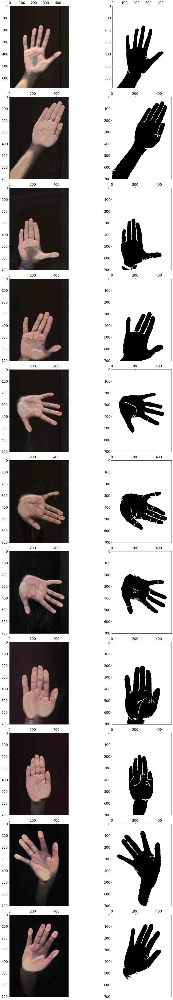

In [450]:
def method1(img):
    img = np.copy(img)
    img = to_1ch(img, 'r')

    mask = filter_mask(img, factor=0.0) > 0
    
    mask = set_padding(mask, 50, False)
    mask = remove_small_objects(mask, 10000, connectivity=2)
    mask = set_padding(mask, -50)
    return mask

def get_mask_1(img):
    mask_ = method1(img)
    img = to_1ch(img, 'r')
#     img = equalize_hist(img)
#     img = to_bin_uint8(to_bin(img))

    
    img_for_edge = img
    v, s, w = 2, 3, 1
    grad_x = cv2.Sobel(img_for_edge, cv2.CV_64F, v, 0, ksize=s)
    grad_y = cv2.Sobel(img_for_edge, cv2.CV_64F, 0, v, ksize=s)
    abs_grad_x = cv2.convertScaleAbs(grad_x)
    abs_grad_y = cv2.convertScaleAbs(grad_y)
    grad = cv2.addWeighted(abs_grad_x, w, abs_grad_y, w, 0)

    grad = cv2.dilate(grad, disk(1))
#     show_image_cv(grad)
    mask_ = to_bin_uint8(mask_)
#     mask_new = cv2.dilate(mask_, disk(5)) > 0
    img_1 = img_sub(img, grad) #* mask_new
    img_1 = cv2.adaptiveThreshold(img_1,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
                                  cv2.THRESH_BINARY,11,2) > 0
#     img_1 = binary_fill_holes(img_1, disk(1))
    img_1 = img_1 * mask_
    img_1 = remove_small_holes(img_1, 500)
#     img_1 = binary_closing(img_1, disk(2))
    img_1 = remove_small_objects(img_1, 150)
#     img_1 = to_bin_uint8(to_bin(img_1))
#     show_image_cv(img_1)
    return img_1
#     img_1 = img_1 * mask_
#     img_2 = filter_mask(img_1, factor=0)
    img_2 = to_bin_uint8(to_bin(img_1))
    img_2 = to_bin_uint8(binary_fill_holes(img_2, disk(1)))
#     show_image_cv(img_2)
    # show_images([img_1, img_2])

    # grad2 = cv2.dilate(grad, disk(1))
    # grad2 = cv2.dilate(grad, square(5))
    # show_image_cv(grad2)
    # show_image_cv(img_sub(img, grad2))
    return img_2

# img = np.copy(src_images[3])
# mask_1 = get_mask_1(img)
# mask_2 = get_mask_2(img)
# show_images_cv([mask_1, mask_2, mask_1 + mask_2], ['1', '2', '1 + 2'])

dmp = []

# 24 25 46 65 66
# lst = [24, 25, 46, 65, 66]
# lst = [0, 1, 2, 42, 43, 44, 45, 46, 47, 48, 49][:3]
lst = [0, 1, 6, 10, 14, 25, 37, 40, 56, 65, 66]
for i in lst:
    img = np.copy(images[i])
    name = names[i]
    
#     mask1 = method1(img)
#     mask1 = binary_opening(mask1, disk(3))
#     mask2 = method2(img, mask1)
#     mask2 = method3(img, mask1)
    mask2 = get_mask_1(img)
#     mask2 = method2(to_1ch(img, 'r') * mask1, mask1)

#     show_image_cv(img, f'{i}. {name}')
#     show_image_cv(mask, f'{i}. {name}')
    dmp.append(img)
# #     dmp.append(mask1)
    dmp.append(mask2)
    
show_images(dmp, n_in_row=2)

100%|██████████████████████████████████████████████████████████████████████████████████| 67/67 [00:02<00:00, 30.38it/s]


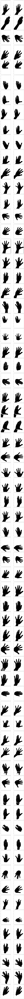

In [976]:
# def get_mask_2(img):
#     img = sharpen(img, 3, 10)
# #     show_image_cv(img)

#     # bin = to_bin_uint8(to_bin(img))
#     _, bin = cv2.threshold(img, 80, 255, cv2.THRESH_BINARY)
# #     show_image_cv(bin)

#     # bin = to_bin_uint8(binary_opening(bin, disk(10)))
#     bin = bin > 0
#     # bin = to_bin_uint8(binary_opening(bin, disk(10)))
# #     bin = to_bin_uint8(erosion(bin, disk(2)))
#     # bin = to_bin_uint8(thin(bin, 2))
#     bin = to_bin_uint8(binary_closing(bin, disk(1)))
#     bin = to_bin_uint8(binary_fill_holes(bin, disk(1)))
# #     show_image_cv(bin)
#     # _, bin = cv2.threshold(img, 100, 255, cv2.THRESH_BINARY)
#     # show_image_cv(bin)
#     return bin
# cv2.adaptiveThreshold(edges,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
#                                   cv2.THRESH_BINARY,11,2)

def method2(img):
    img_src = np.copy(img)

#     img = cv2.GaussianBlur(img, (3,3), 0)
#     img = cv2.medianBlur(img, 3)
    img = cv2.GaussianBlur(img, (5,5), 0)
    
    v, s, w = 2, 3, 3
    grad_x = cv2.Sobel(img, cv2.CV_64F, v, 0, ksize=s)
    grad_y = cv2.Sobel(img, cv2.CV_64F, 0, v, ksize=s)
    abs_grad_x = cv2.convertScaleAbs(grad_x)
    abs_grad_y = cv2.convertScaleAbs(grad_y)
    edges = cv2.addWeighted(abs_grad_x, w, abs_grad_y, w, 0)
    
#     edges = cv2.medianBlur(edges, 3)
#     m = method1(img_src)
#     edges = edges * m
    edges = edges * to_bin(edges, 60)

#     edges = cv2.GaussianBlur(edges, (3,3), 0)
#     edges = sharpen(edges, 3, 5)
#     edges = cv2.GaussianBlur(edges, (3,3), 0)
    
#     edges = cv2.GaussianBlur(edges, (3,3), 0)
    edges = sharpen(edges, 3, 2)
#     edges = cv2.GaussianBlur(edges, (5,5), 0)
#     edges = sharpen(edges, 3, 3)
#     edges = cv2.dilate(edges, disk(1))
#     edges = cv2.medianBlur(edges, 3)
#     edges = thick(edges, 2)

    img = img_sub(img, edges)
#     edges = sharpen(img, 3, 1)
#     img = cv2.GaussianBlur(img, (3,3), 0)
    return img

def method1(img):
    img = np.copy(img)

    mask = filter_mask(img, factor=0.0) > 0
#     mask = to_bin(img)
#     mask = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
#                                   cv2.THRESH_BINARY,11,2) > 0
    
    mask = set_padding(mask, 50, False)
    mask = remove_small_objects(mask, 10000, connectivity=2)
    mask = set_padding(mask, -50)
    return mask

dmp = []

for i in tqdm(range(len(images))):#[1, 6, 25]:
    img = np.copy(images[i])
    name = names[i]
    

#     mask = cv2.adaptiveThreshold(edges,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
#                                   cv2.THRESH_BINARY,11,2)
    red = to_1ch(img, 'r')
    img = method2(red)
#     dmp.append(img)
    mask = method1(img)
#     mask = thin(mask, 1)
#     mask = erosion(mask, square(3))
#     mask = thin(mask, 1)
#     mask = thin(mask, 1)
#     mask = binary_opening(mask, disk(1))
    dmp.append(mask)
#     m2 = method1(red)
    mask = binary_fill_holes(mask, disk(1))
    mask = remove_small_objects(mask, 100)
    
    dmp.append(mask)
    
    
#     dmp.append(img)
#     dmp.append(edges)
#     dmp.append(img)
    
#     img = np.copy(images[i])
#     img = to_1ch(img, 'r')
#     mask = get_mask_2(img)
#     dmp.append(mask)
    
#     dmp.append(mask2)

show_images(dmp, n_in_row=2)

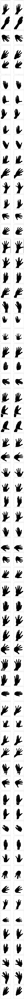

In [977]:
show_images(dmp, inds, n_in_row=2)

  0%|                                                                                           | 0/15 [00:00<?, ?it/s]

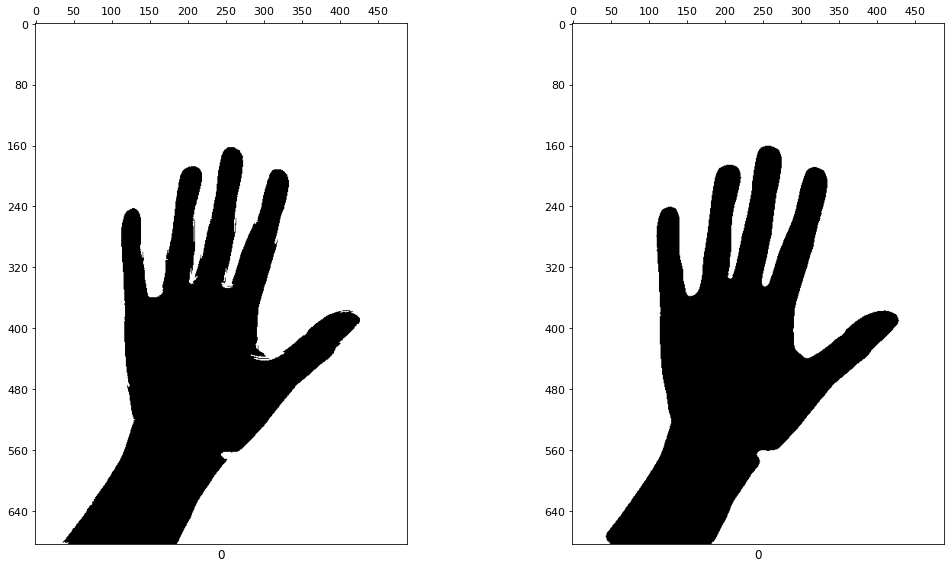

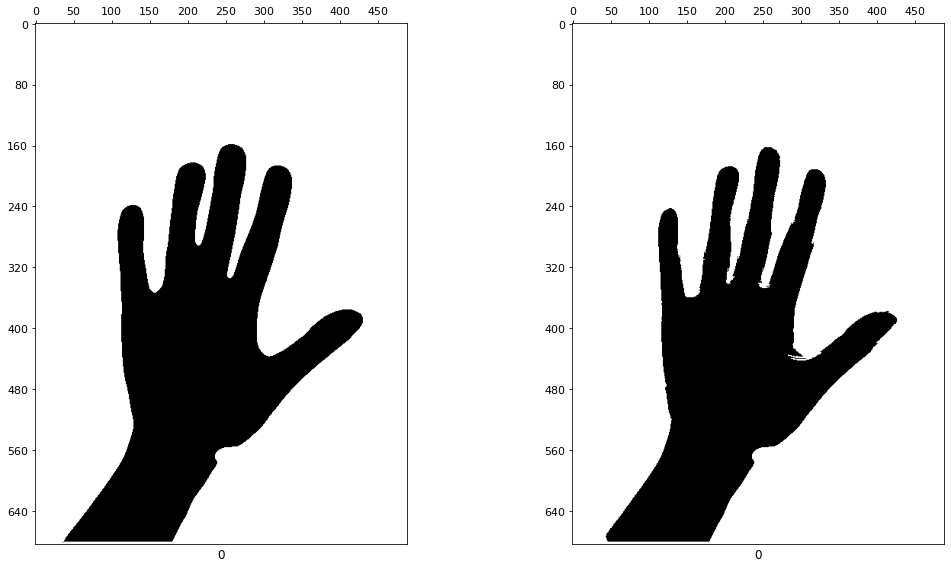

  7%|█████▌                                                                             | 1/15 [00:01<00:15,  1.13s/it]

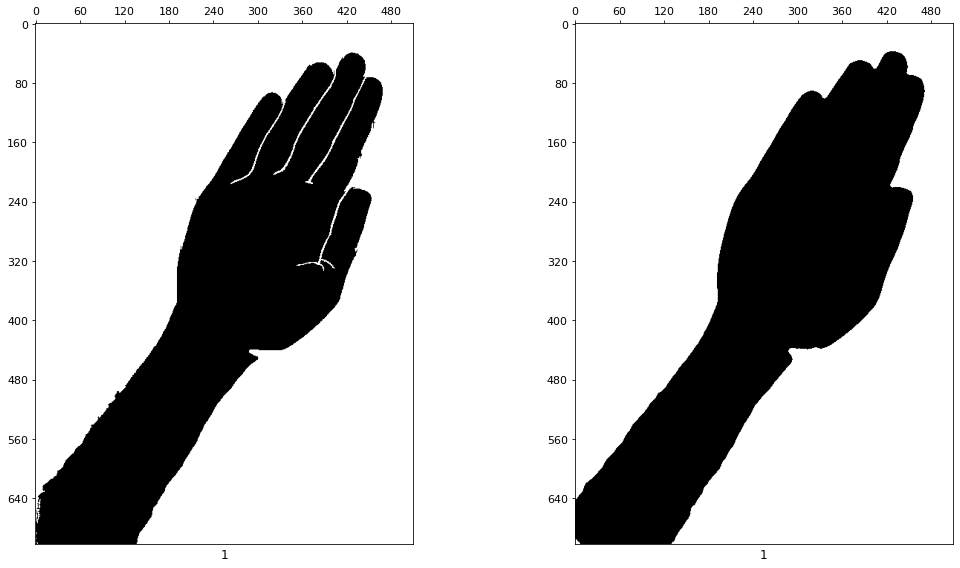

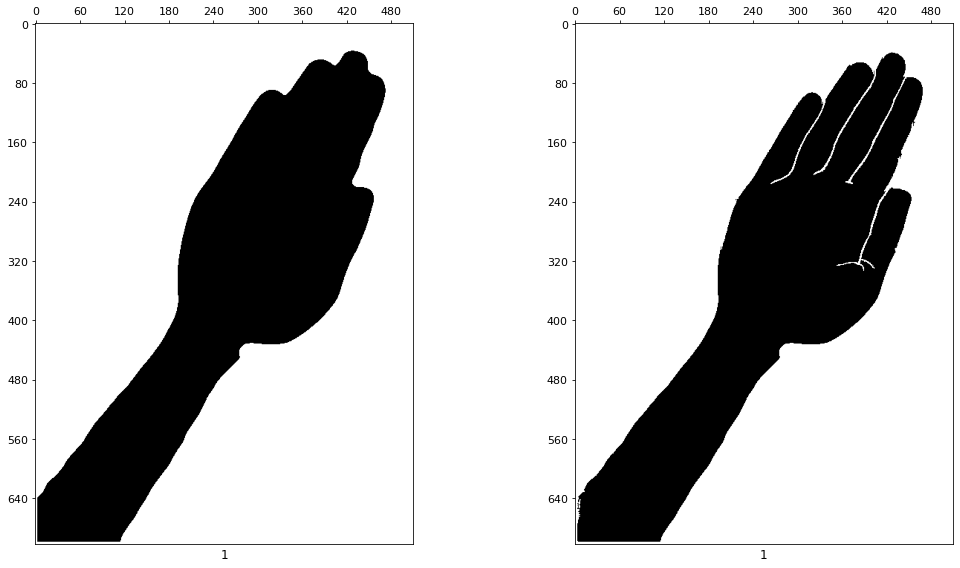

 13%|███████████                                                                        | 2/15 [00:02<00:14,  1.14s/it]

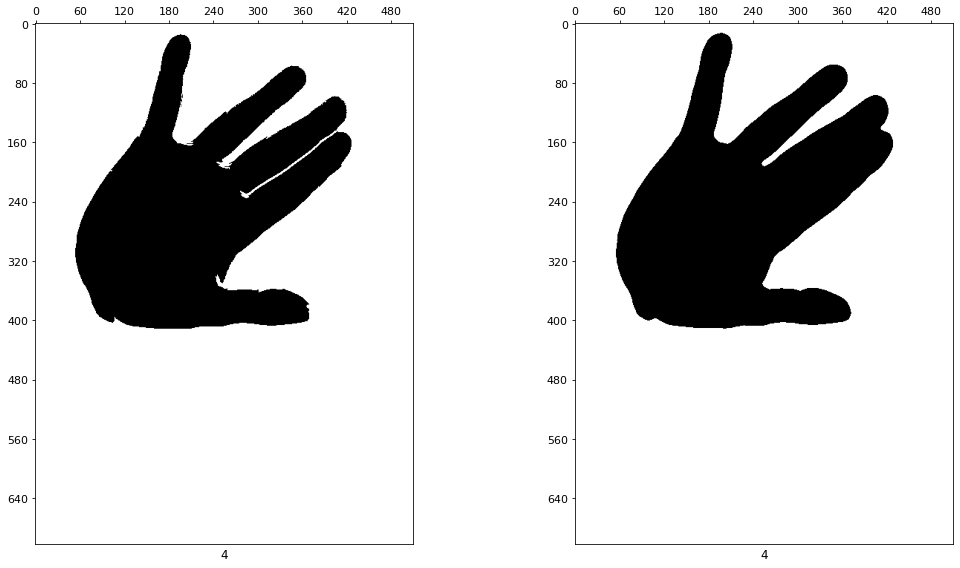

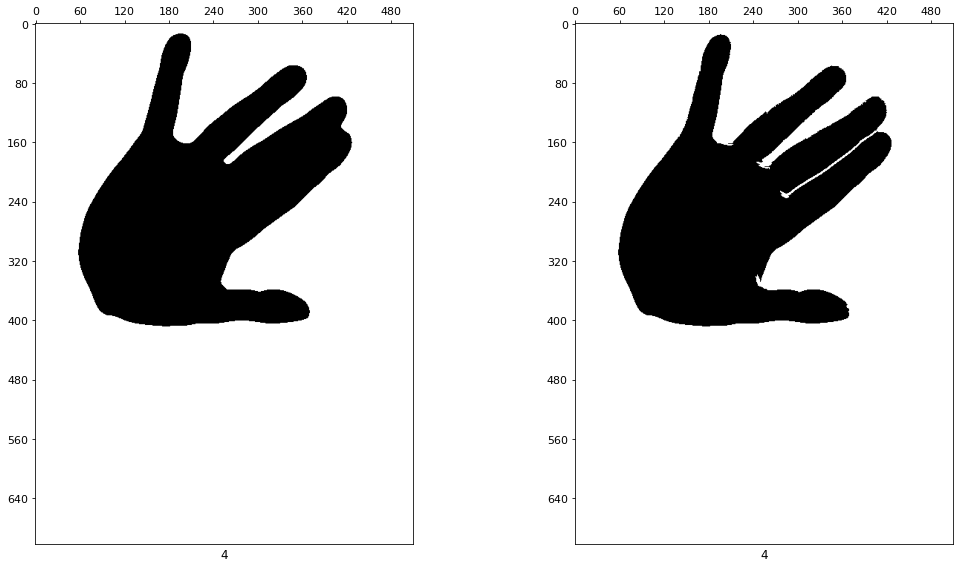

 20%|████████████████▌                                                                  | 3/15 [00:03<00:13,  1.11s/it]

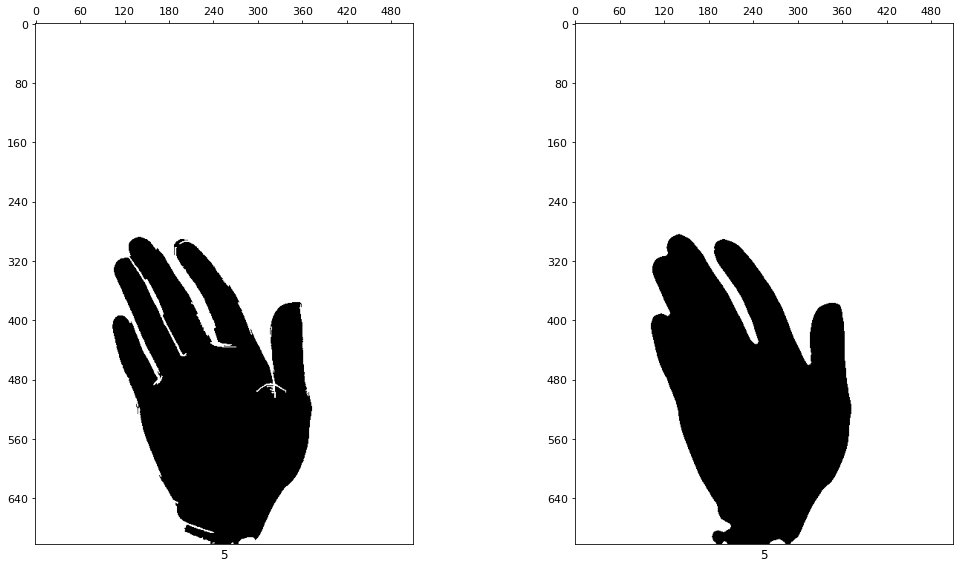

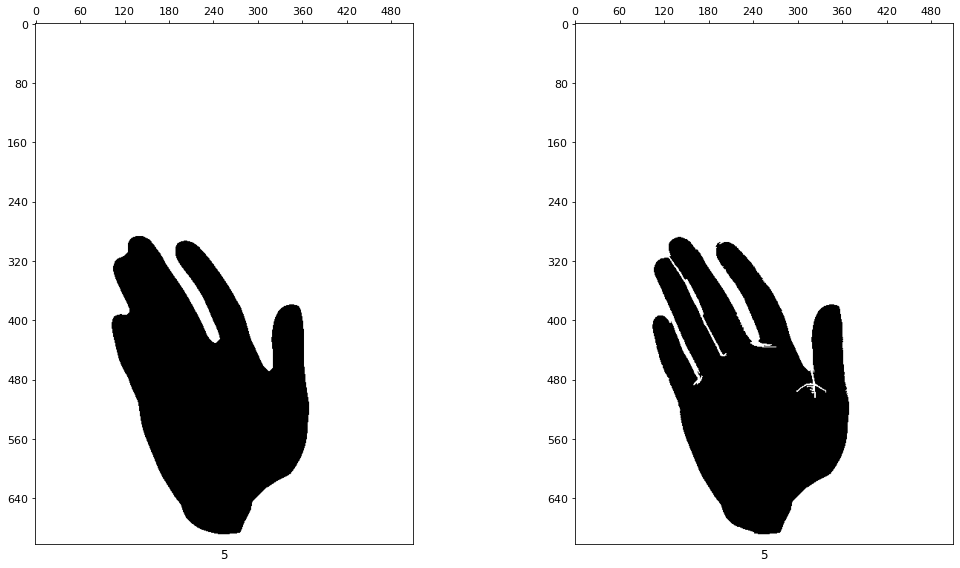

 27%|██████████████████████▏                                                            | 4/15 [00:04<00:12,  1.14s/it]

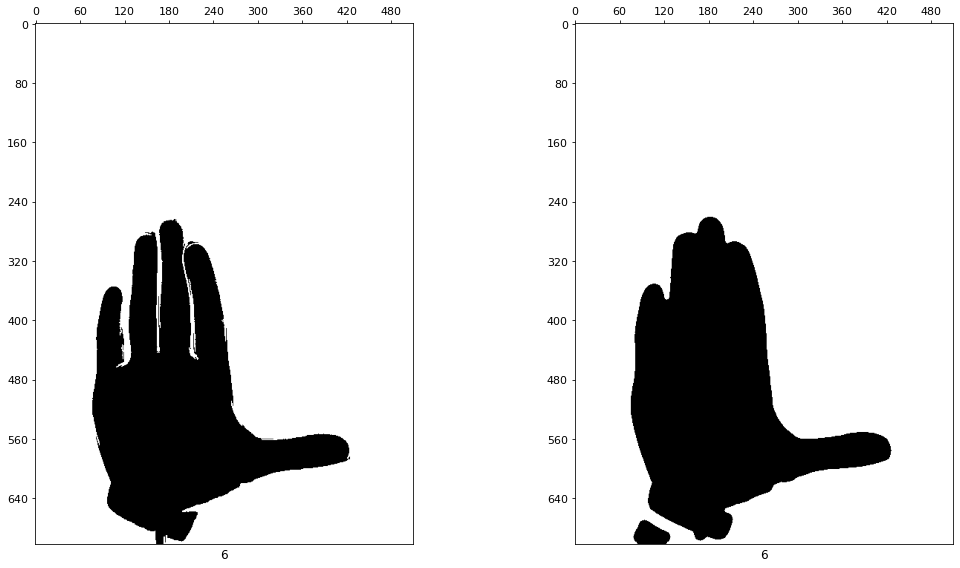

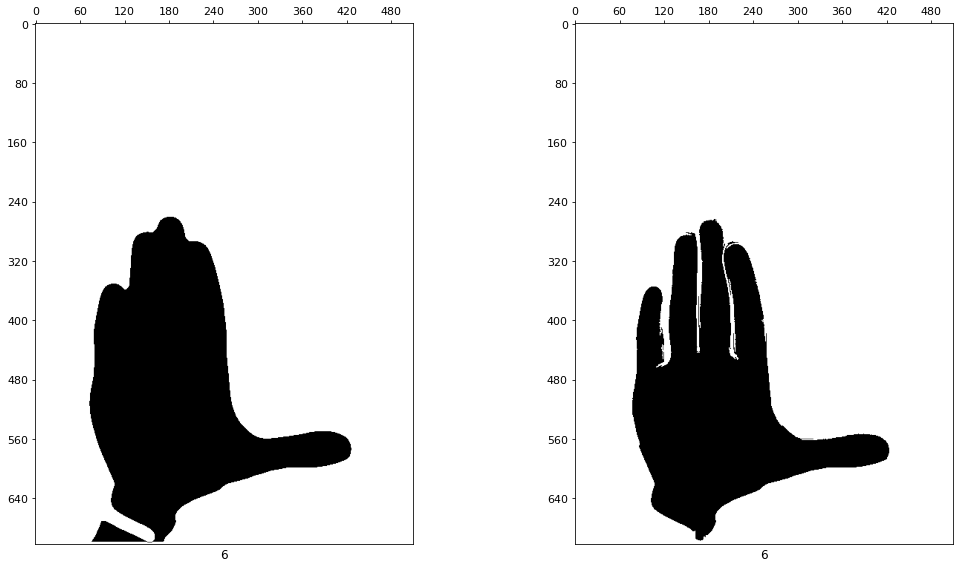

 33%|███████████████████████████▋                                                       | 5/15 [00:05<00:11,  1.17s/it]

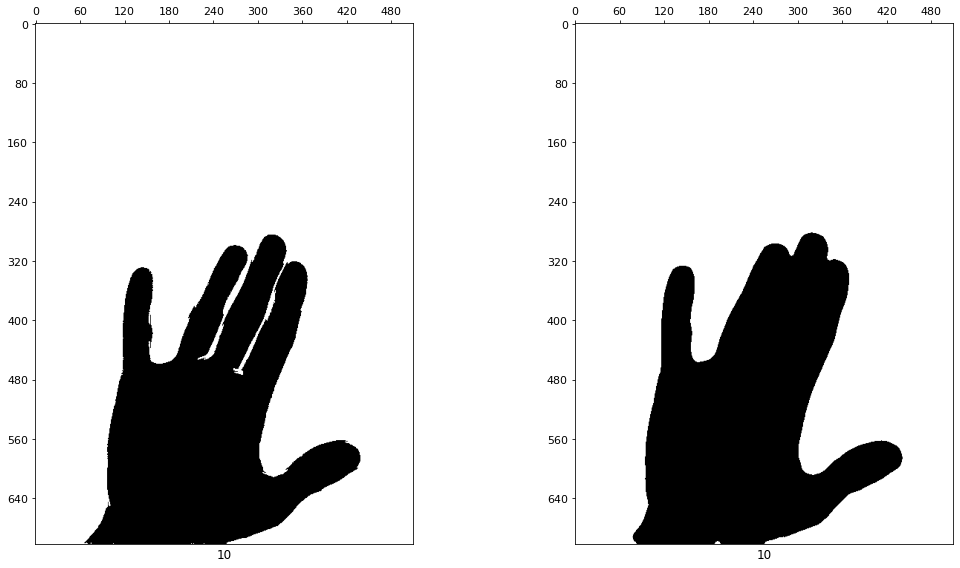

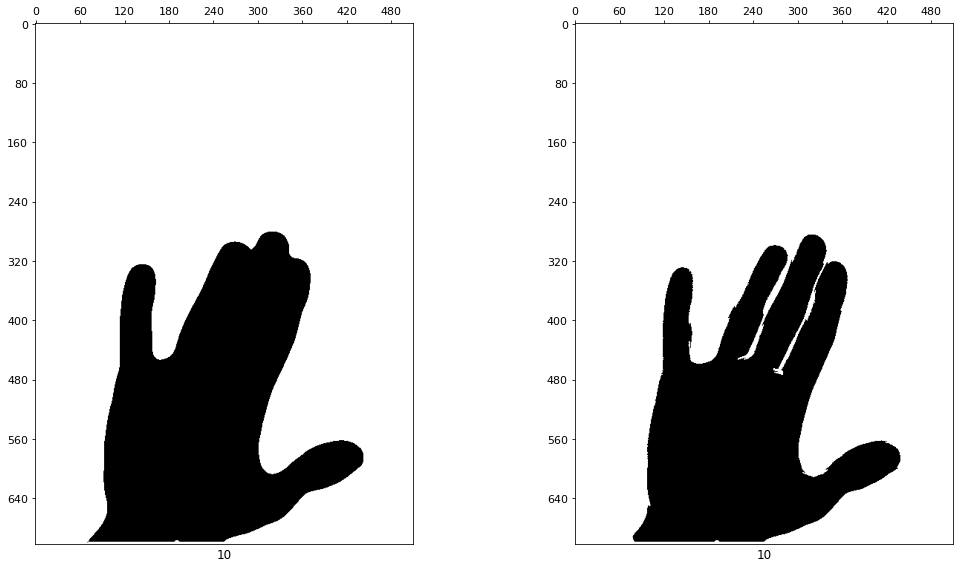

 40%|█████████████████████████████████▏                                                 | 6/15 [00:06<00:10,  1.16s/it]

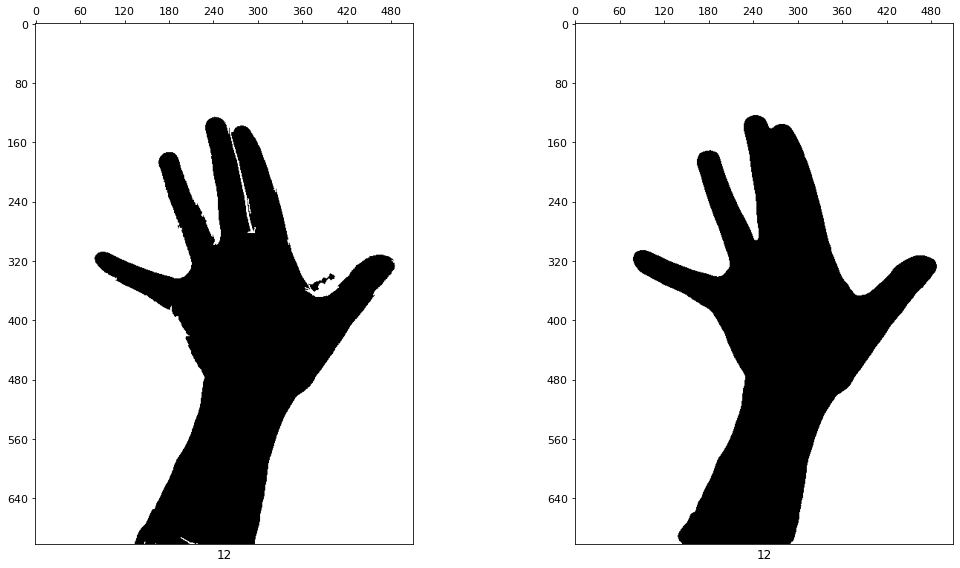

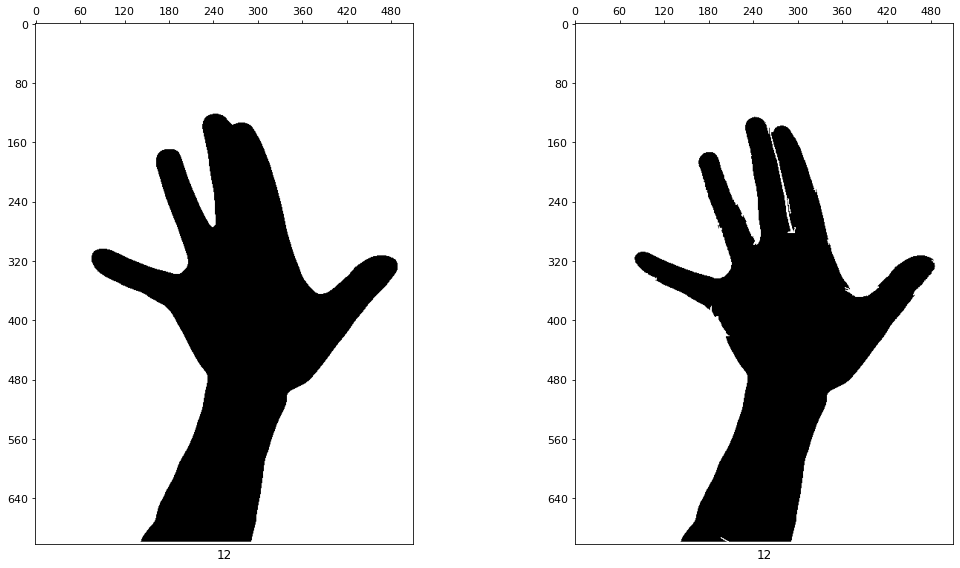

 47%|██████████████████████████████████████▋                                            | 7/15 [00:08<00:09,  1.20s/it]

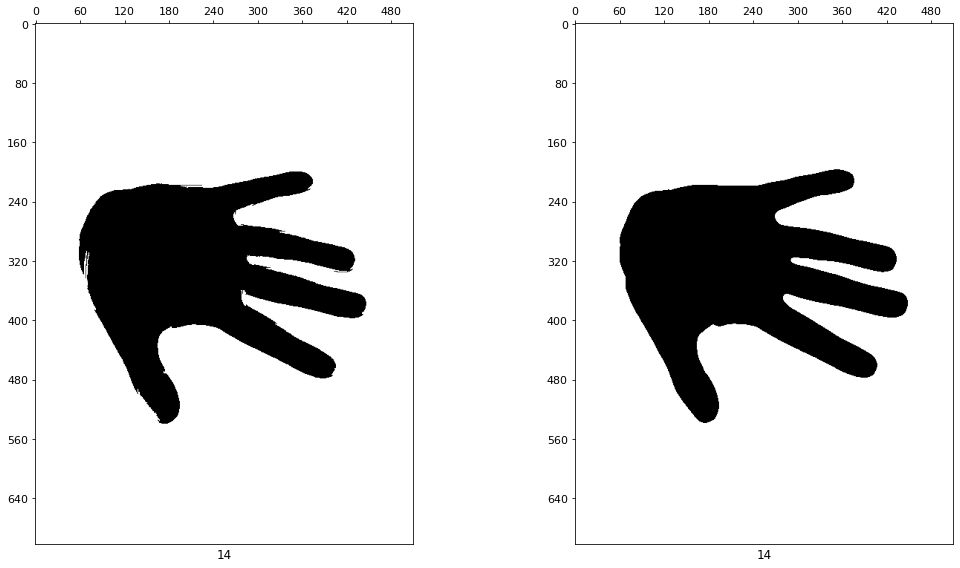

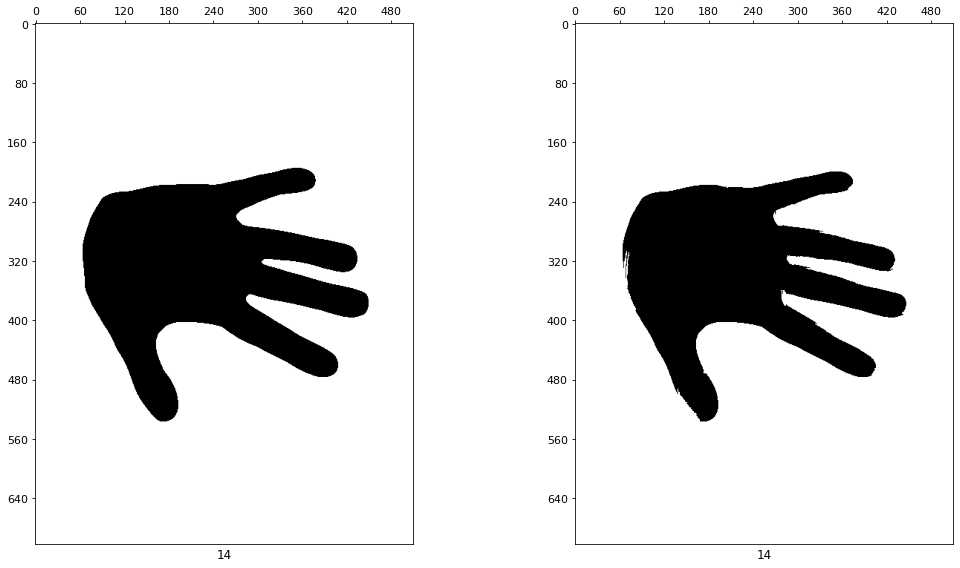

 53%|████████████████████████████████████████████▎                                      | 8/15 [00:09<00:08,  1.22s/it]

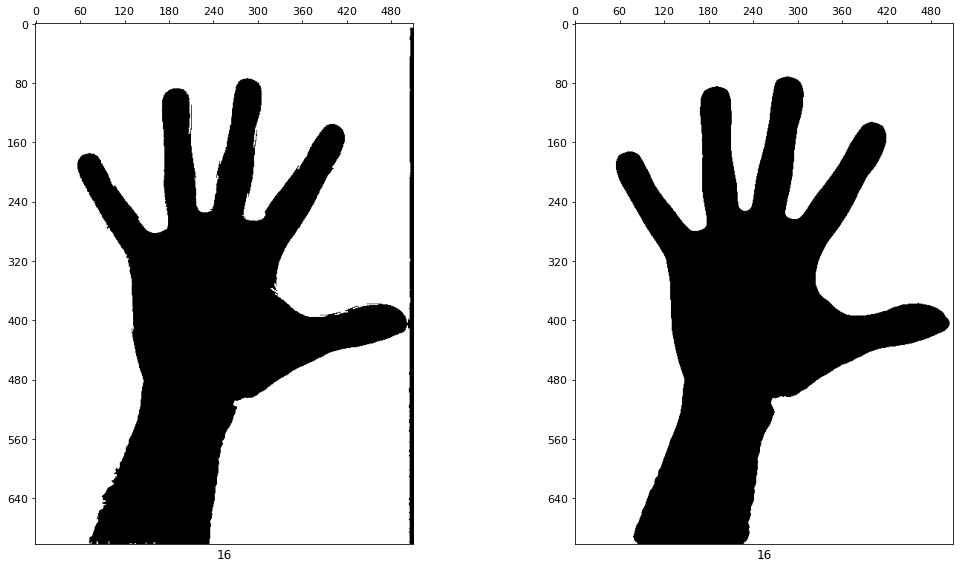

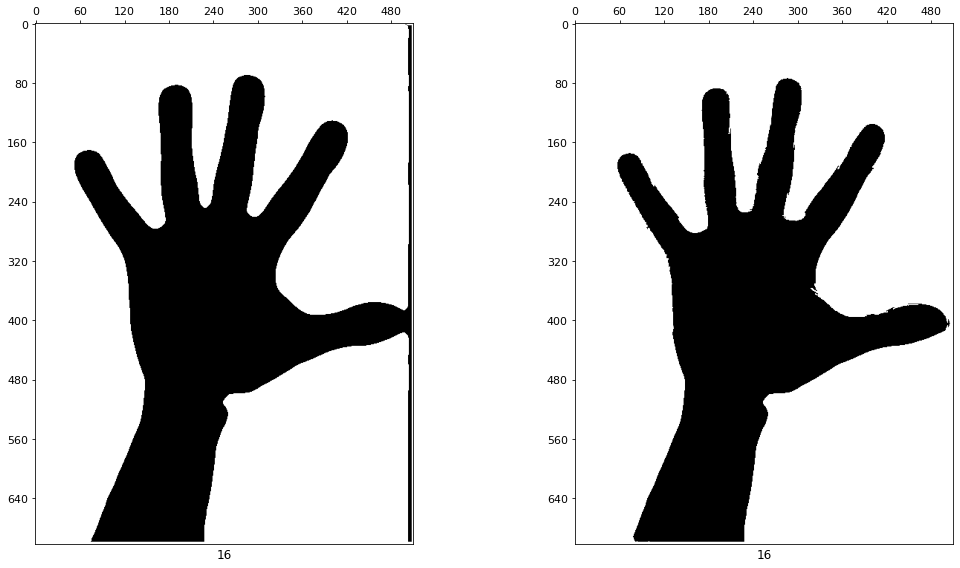

 60%|█████████████████████████████████████████████████▊                                 | 9/15 [00:10<00:07,  1.23s/it]

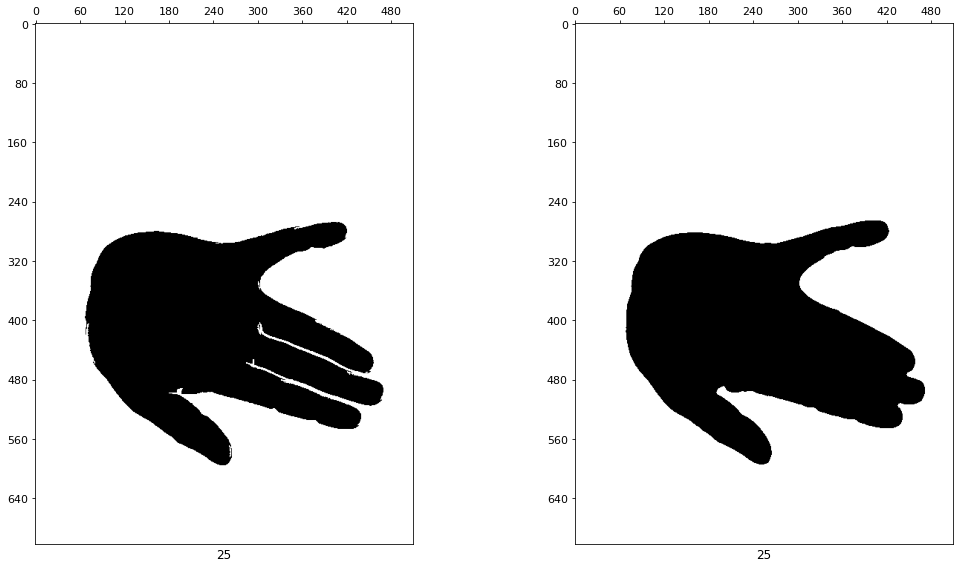

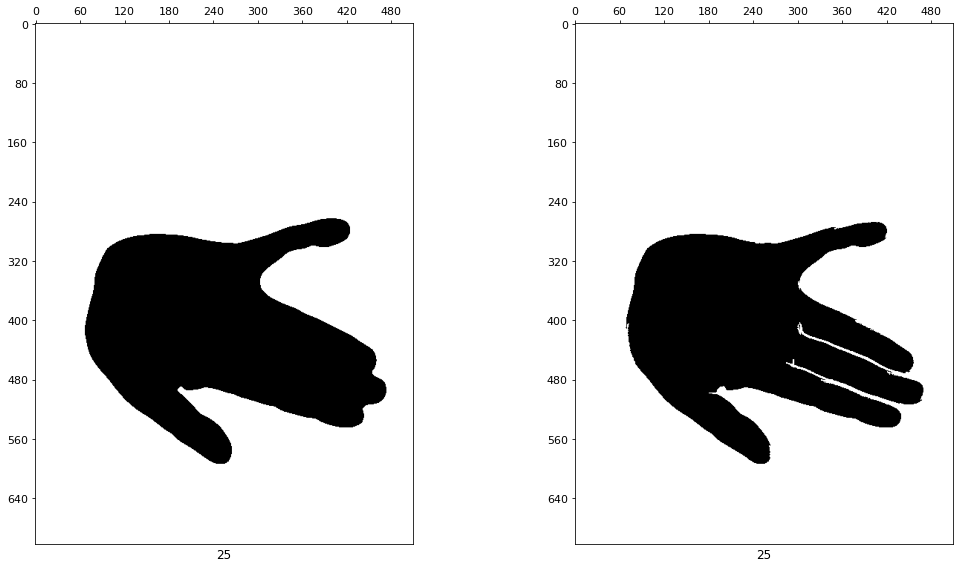

 67%|██████████████████████████████████████████████████████▋                           | 10/15 [00:11<00:06,  1.25s/it]

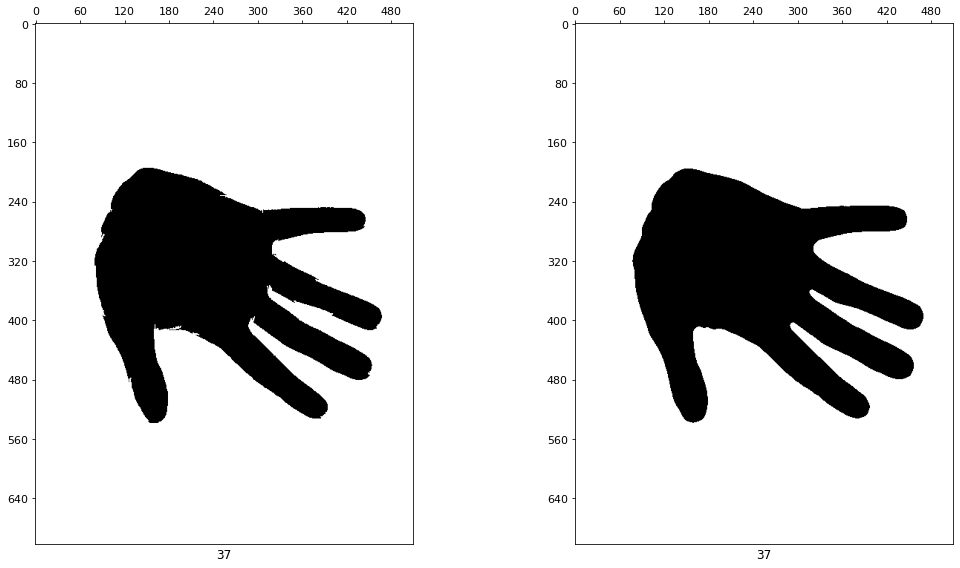

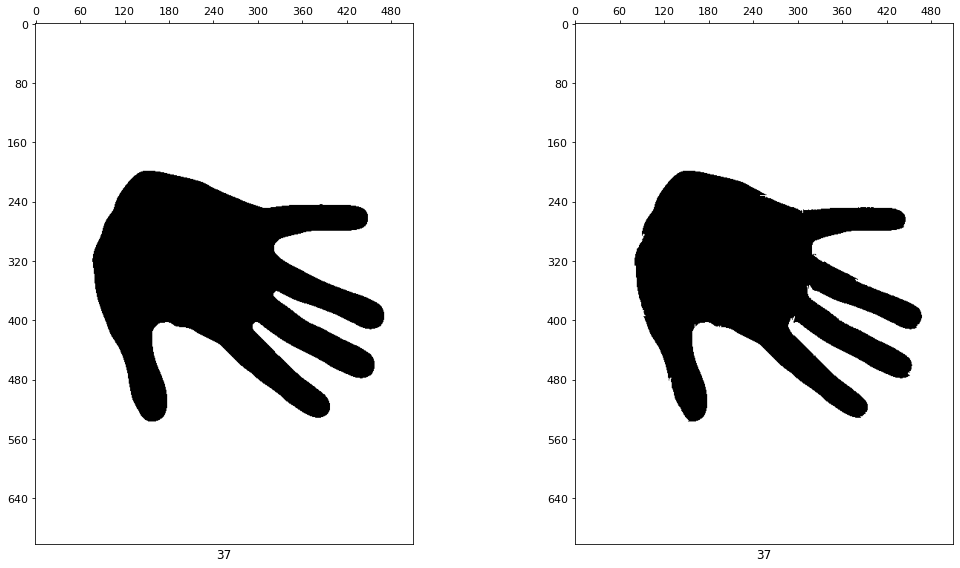

 73%|████████████████████████████████████████████████████████████▏                     | 11/15 [00:13<00:04,  1.22s/it]

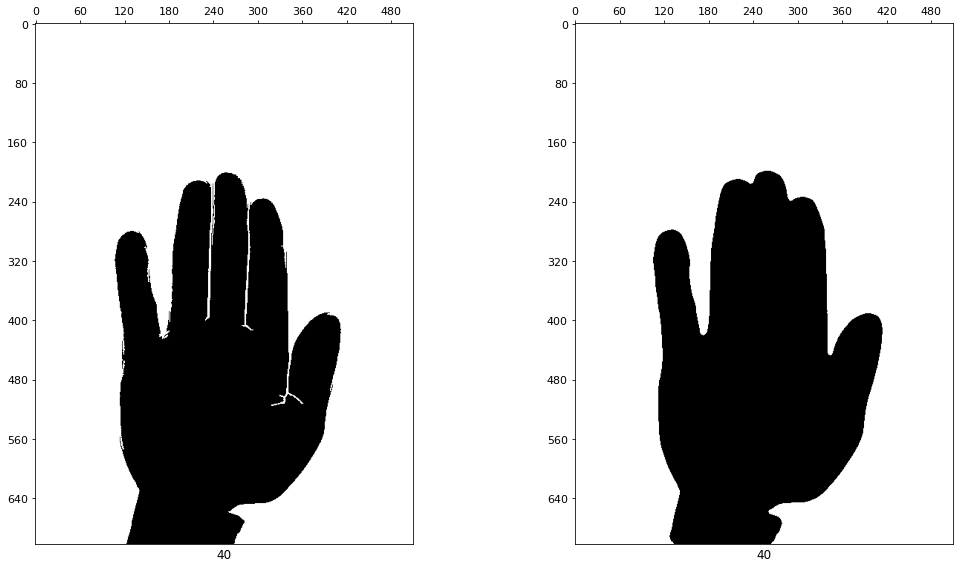

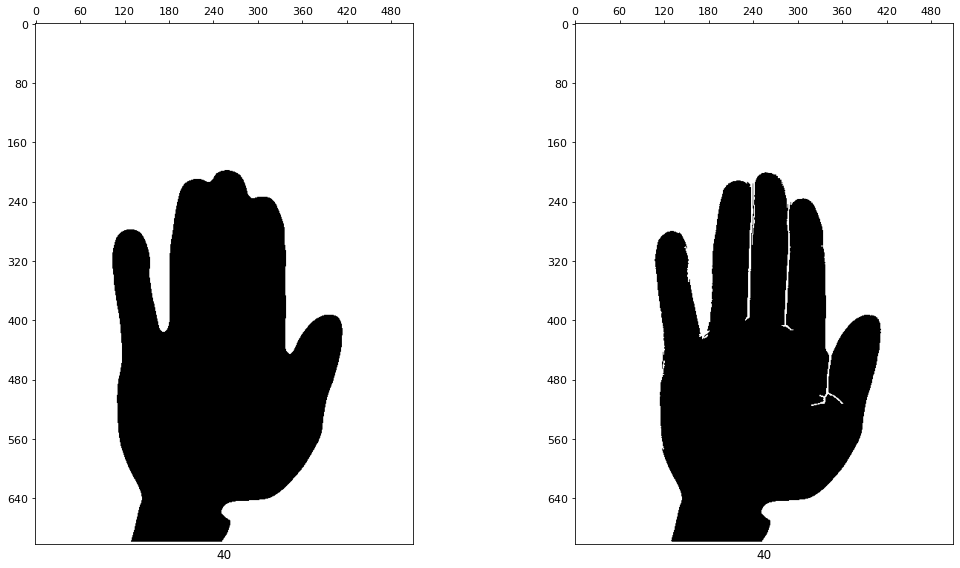

 80%|█████████████████████████████████████████████████████████████████▌                | 12/15 [00:14<00:03,  1.20s/it]

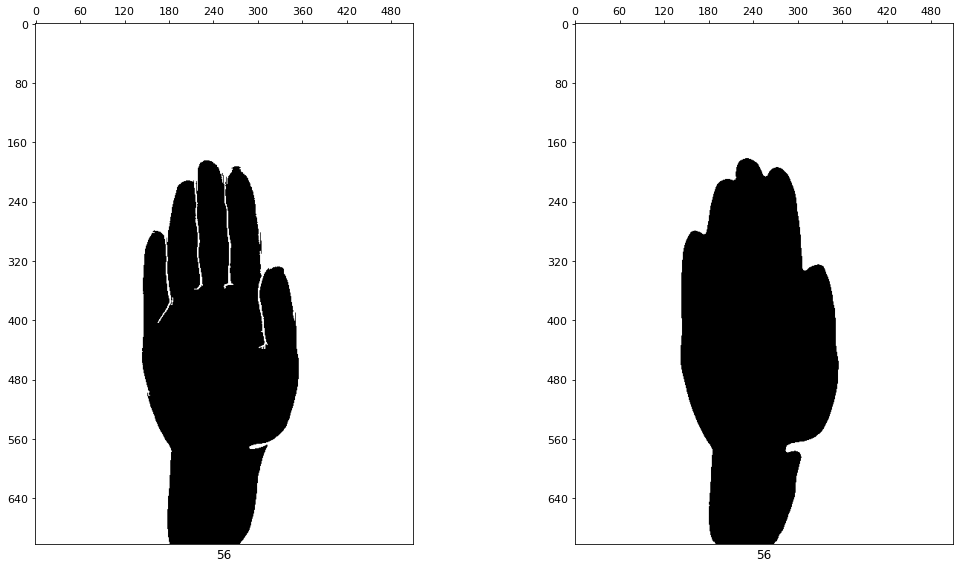

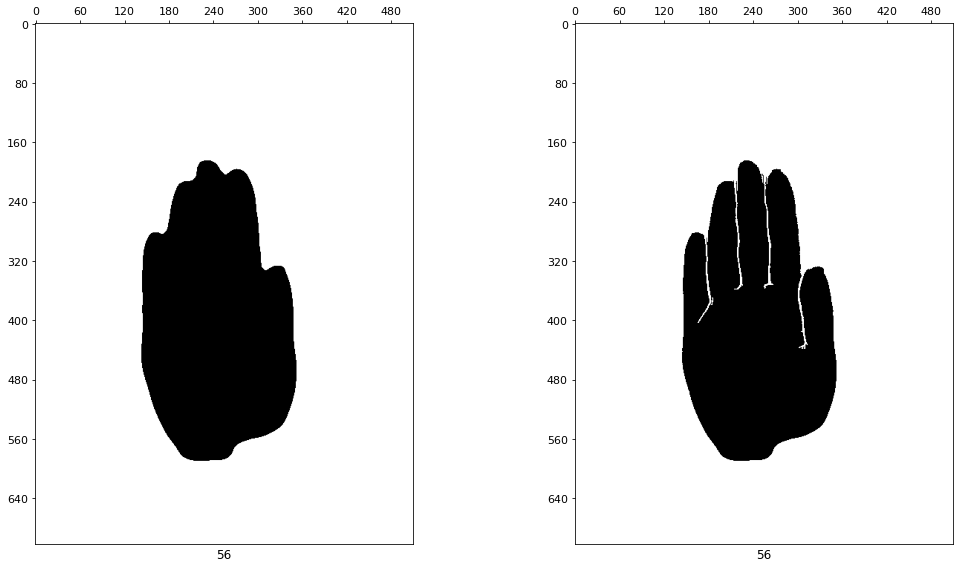

 87%|███████████████████████████████████████████████████████████████████████           | 13/15 [00:16<00:02,  1.23s/it]


KeyboardInterrupt: 

In [1082]:
def method1(img):
    img = np.copy(img)

    mask = filter_mask(img, factor=0.0) > 0

    
    mask = set_padding(mask, 50, False)
    mask = remove_small_objects(mask, 10000, connectivity=2)
    mask = set_padding(mask, -50)
    return mask

def get_main_mask(img):
    img = method2(img)
    mask = method1(img)
    mask = binary_fill_holes(mask, disk(1))
    mask = remove_small_objects(mask, 100)
    return mask

def get_clean_mask_1(img):
    img = np.copy(img)
    mask = method1(img)

    mask = thin(mask, 4)
    mask = binary_opening(mask, disk(5))

    mask = dilation(mask, disk(3))
    mask = binary_fill_holes(mask, disk(1))
    mask = binary_closing(mask, disk(3))
    mask = binary_fill_holes(mask, disk(1))
    return mask

def get_clean_mask_2(img):
    img = np.copy(img)

    img = cv2.GaussianBlur(img, (25, 25), 0)
    
    mask = get_main_mask(img)
    mask = thin(mask, 3)
    return mask

dmp = []
inds = []

lst = [0, 1, 4, 5, 6, 10, 12, 14, 16, 25, 37, 40, 56, 65, 66]
# lst = range(len(images))
for i in tqdm(lst): #:#[1, 6, 25]:
    img = np.copy(images[i])
    name = names[i]

    red = to_1ch(img, 'r')
    
    main_mask = get_main_mask(red) > 0
    mask1 = get_clean_mask_1(red) > 0
    mask2 = get_clean_mask_2(red) > 0

    res = main_mask * mask1 * mask2
#     res = binary_opening(res, disk(1))
    res = remove_small_objects(res, 500)

    show_images([main_mask, mask1], [i, i], n_in_row=2)
    show_images([mask2, res], [i, i], n_in_row=2)

In [1031]:
def get_palm_mask(img):
    red = to_1ch(img, 'r')

    main_mask = get_main_mask(red) > 0
    mask1 = get_clean_mask_1(red) > 0
    mask2 = get_clean_mask_2(red) > 0

    res = main_mask * mask1 * mask2
    res = binary_opening(res, disk(1))
    res = remove_small_objects(res, 500)
    
    return res

In [845]:
def filter_mask(img, factor=0.5, thr_a=0, thr_b=255, add_a=0, add_b=0, vis=False):
    y, x = list(map(np.array, histogram(img)))
    
    y_mean = np.mean(y)
    y_med = np.median(y)
    thr = y_med + np.abs(y_mean - y_med) * factor

    i0 = np.argmax(y)  
    i1, i2 = i0, i0
    i_min, i_max = 0, thr_b - thr_a

    for i in range(i0, i_min - 1, -1):
        if not (y[i] > thr):
            i1 = i
            break
        
    for i in range(i0, i_max + 1):
        if not (y[i] > thr):
            i2 = i
            break
            
    x1, x2 = x[i1], x[i2]
    
    x1 += add_a
    if x1 > 255:
        x1 = 255
    elif x1 < 0:
        x1 == 0

    x2 += add_b
    if x2 > 255:
        x2 = 255
    elif x2 < 0:
        x2 == 0

    img = img >= x2
    
    if vis:
        fig = plt.figure(figsize=(8, 8))
        plt.plot(x, y, label='y, histogram')

        y_mean_arr = np.full_like(y, y_mean)
        y_med_arr = np.full_like(y, y_med)
        thr_arr = np.full_like(y, thr)

        plt.plot(x, y_mean_arr, label='y mean')
        plt.plot(x, y_med_arr, label='y median')
        plt.plot(x, thr_arr, label='threshold')

        plt.plot(x1, y[i1], 'bo', label='left bound')
        plt.plot(x2, y[i2], 'ro', label='right bound')

        plt.legend()
        plt.tick_params(axis='both')
        plt.tight_layout()
    return img

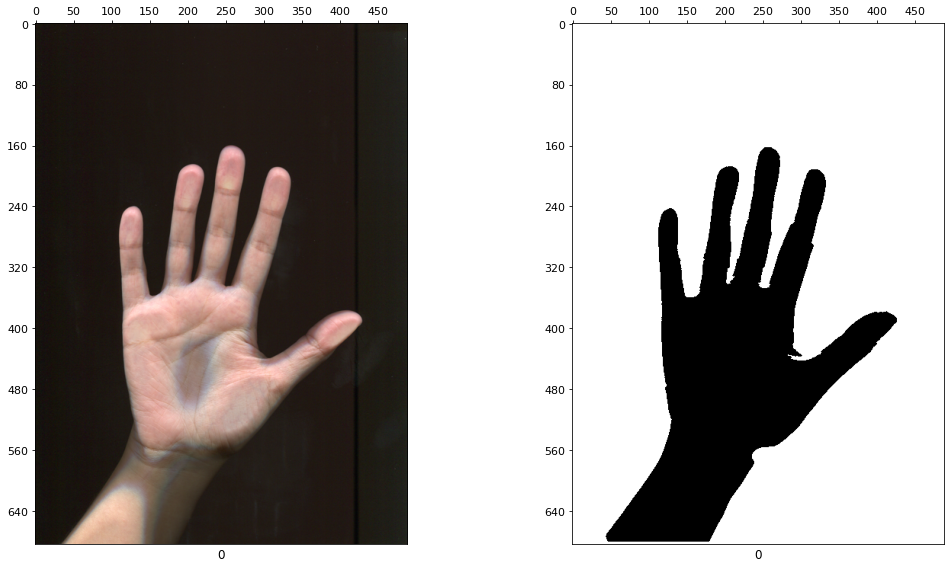

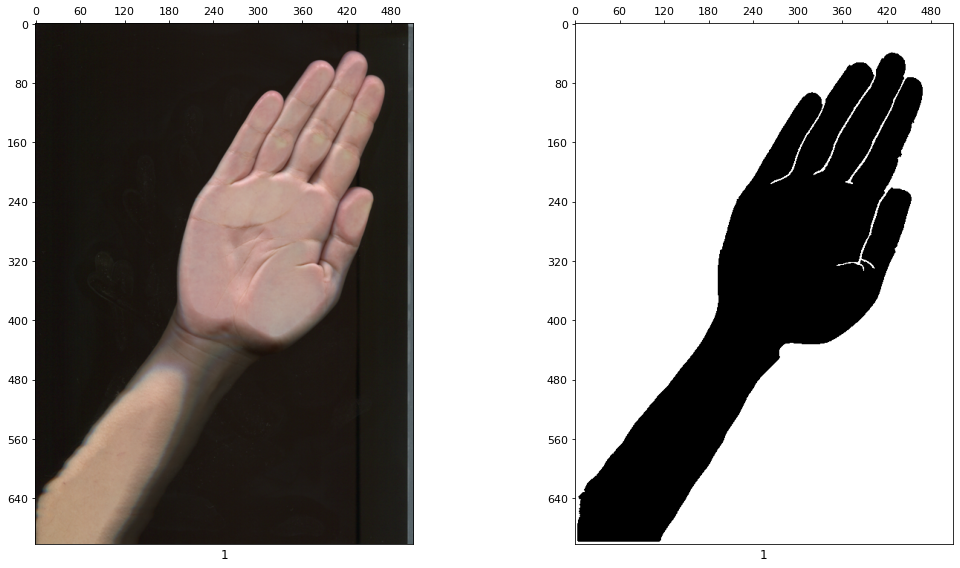

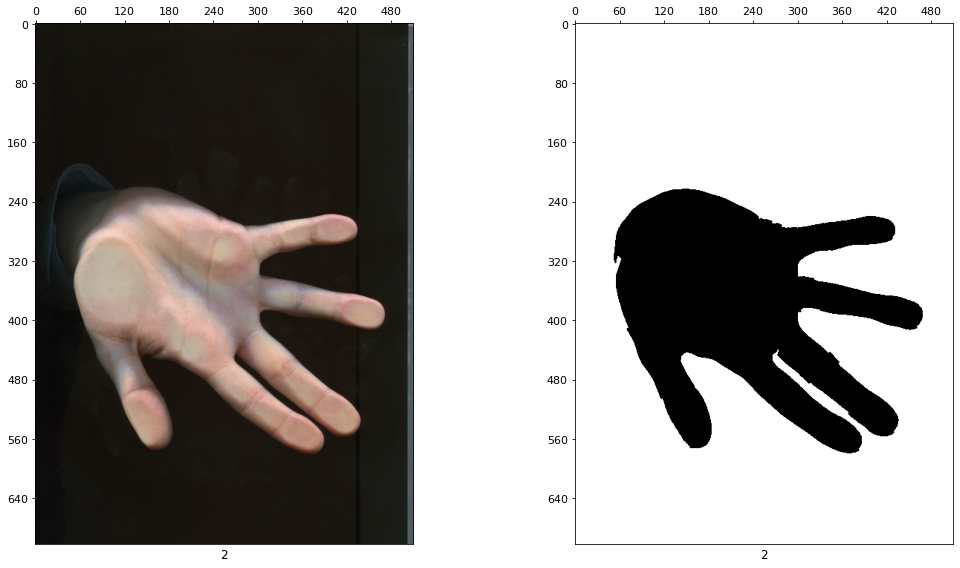

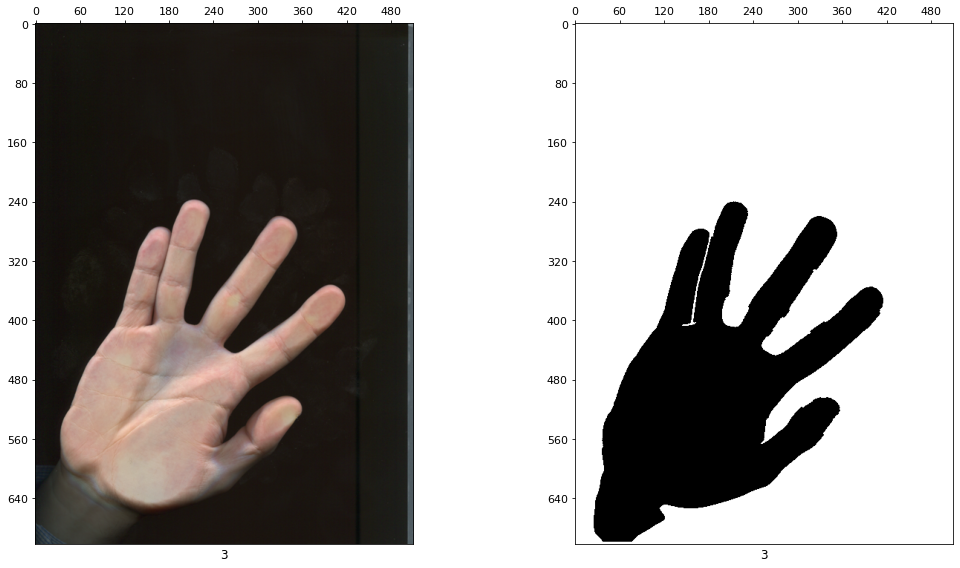

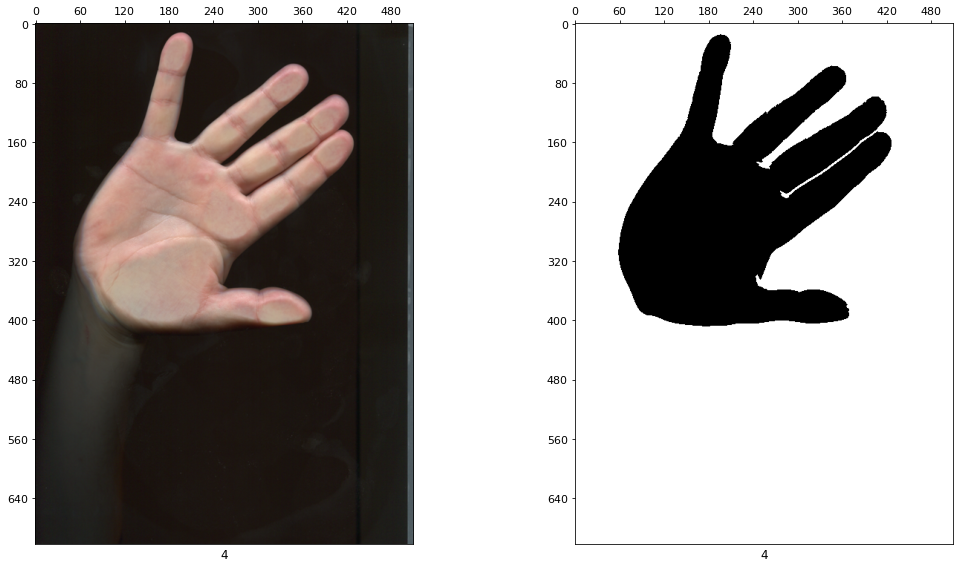

...

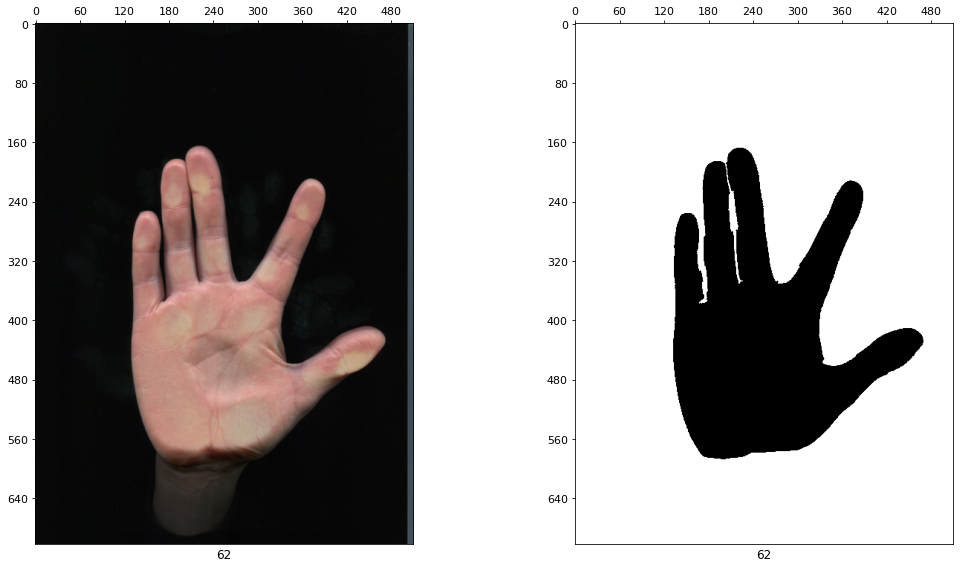

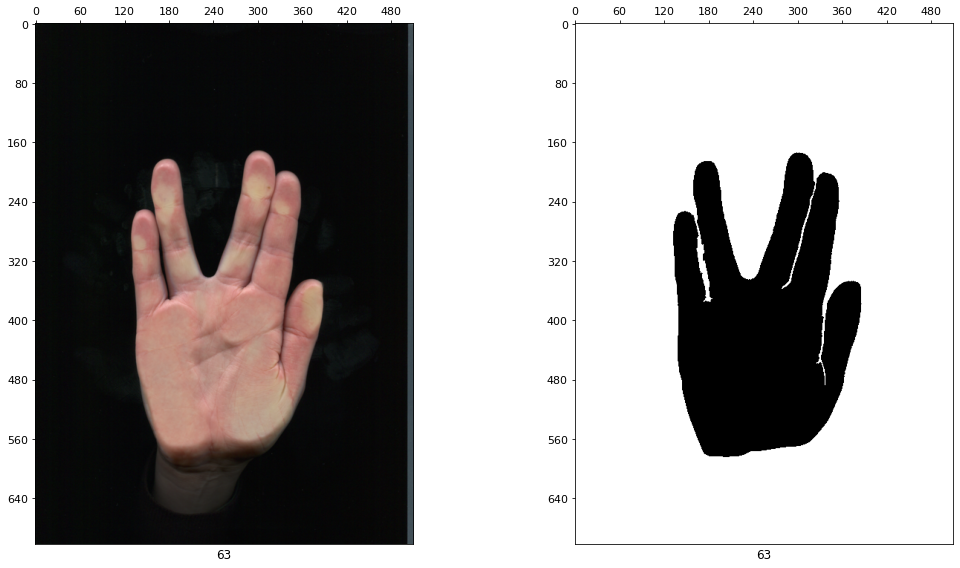

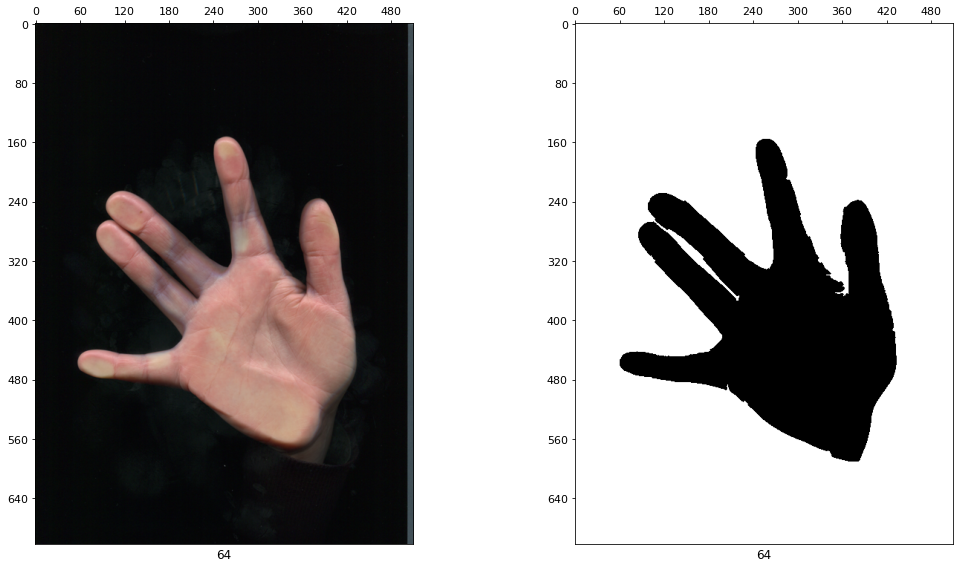

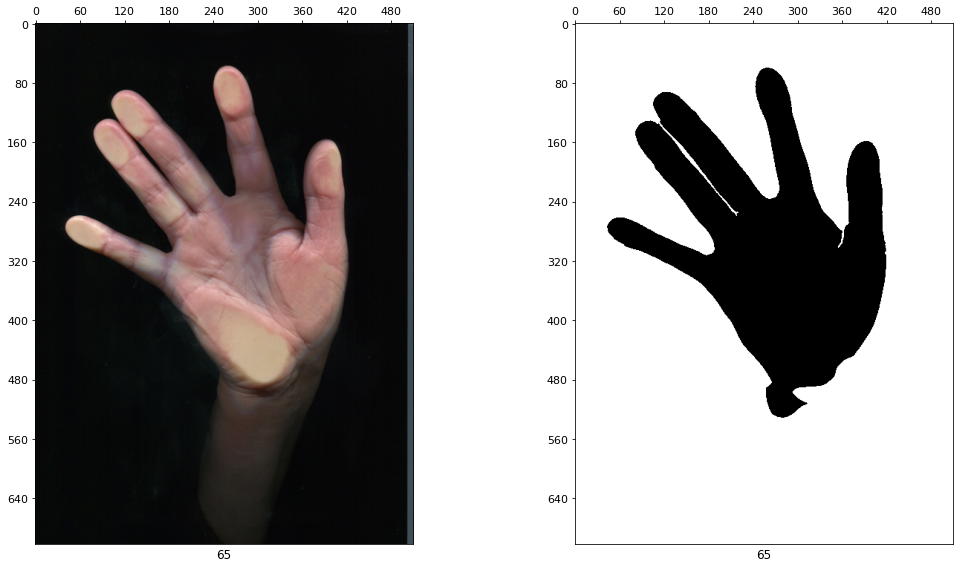

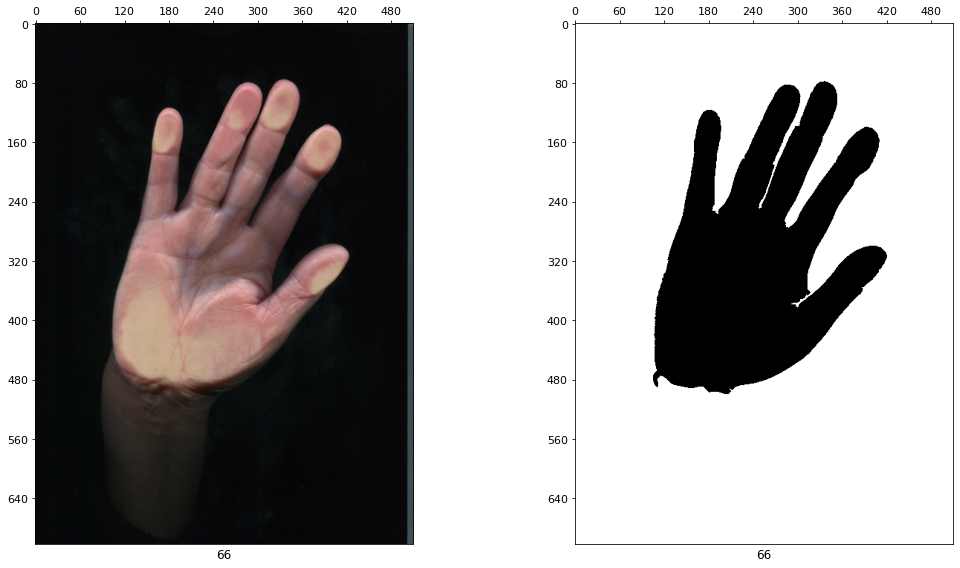

In [1083]:
for i in range(len(images)): #:#[1, 6, 25]:
    img = np.copy(images[i])
    name = names[i]

    mask = get_palm_mask(img)

    show_images([img, mask], [i, i], n_in_row=2)